### Agenda
- Introduction to prompt Engineering
- Important terminology related to image prompting
- Prompting using UI
- Prompting using Code

### 1. Introduction to Prompt Engineering

The field of AI is becoming more and more popular everyday. This is, in part, thanks to the capabilities of generative AI models such as ChatGPT (for language), Stable Diffusion (for images), and so on.

You are already familiar with prompt engineering in the case of language models such as ChatGPT. You might have noticed that language models like ChatGPT require a structured description of what you want from it. You can use chain-of-thought methods along with few-shot examples to align your language model instance with what you want.

Image models are slightly different because they are not trained on the same data as language models. Image models are primarily trained on captioned images, so the models pay more attention to keywords rather than elaborate descriptions.

Here's the prompt:
> *Acrylic painting of a cat, shot from far, green meadow, classical art, impressionism, loose brush strokes, bright painting, Outdoors*

This image prompt is essentially a combination of the following elements:
- Foreground
- Background
- Descriptors

**Foreground:** The main subject in your image - *Acrylic painting of a cat*

**Background:** The background in your image - *green meadow*

**Descriptors:** Terms that describe the nature and style of your image - *classical art*, *impressionism*, *loose brush strokes*, and so on

These components of an image prompt can be populated by **keywords** that the image model understands. Recall some prompts that you may have written for ChatGPT. What are some differences between image prompts and text prompts?

In text prompts, with the help of roles, few shot examples, and chain of thoughts reasoning, we tell the model *how* to solve a problem. Whereas in case of image prompts, we need to describe *what* the image should look like in great detail.

Before we move on to important keywords associated with image model prompting, let's first take a look at the motivations behind and the developmental history of image generation models.

### 2. Important Terminolgy Related to Image Prompting

There are many ways to categorize keywords, but here are some popular ones:

- **Style:** *photograph*, *digital illustration*, *3D model*, ...
- **Medium:** *oil*, *watercolor*, *pencil*, *ink*, *pastel*, ...
- **Artists:** *van Gogh*, *Picasso*, *Monet*, ...
- **Media:** *Instagram*, *Pinterest*, *ArtStation*, ...
- **Effects:** *high-resolution*, *grainy*, *pixelated*, ...
- **Color:** *monochrome*, *sepia*, *vibrant*, *warm tones*, *cool tones*, *neutral tones*, ...
- **Lighting:** *backlit*, *twilight*, *spotlight*, ...
- **Camera:** *fisheye*, *wide-angle*, *pinhole*, ...
- **Perspective:** *bird's eye view*, *first person*, *cross section*, ...
- **Artistic movement:** *realism*, *surrealism*, *impressionism*, *romanticism*, ...

### 3. Prompting using UI
- https://chatgpt.com/?model=gpt-4o [closed sourse]
- https://huggingface.co/spaces/stabilityai/stable-diffusion [HuggingFace]
- https://playground.com/ [Free Tier]
- https://dreamstudio.ai/account [Free Credit]

**Basic Style:**
A photograph of a cat.

**Medium:**
A photograph of a cat in watercolor.

**Artist Influence:**
A watercolor painting of a cat in the style of van Gogh.

**Color:**
A vibrant watercolor painting of a cat in the style of van Gogh.

**Lighting:**
A vibrant watercolor painting of a cat in the style of van Gogh, backlit.

**Effect:**
A high-resolution, vibrant watercolor painting of a cat in the style of van Gogh, backlit.

**Camera Perspective:**
A high-resolution, vibrant watercolor painting of a cat in the style of van Gogh, backlit, from a bird's eye view.

**Medium Variation:**
An oil painting of a cat in the style of van Gogh, backlit, from a bird's eye view.

**Artistic Movement:**
An impressionist oil painting of a cat in the style of van Gogh, backlit, from a bird's eye view.

**Additional Detail:**
An impressionist oil painting of a cat in the style of van Gogh, backlit, from a bird's eye view, with vibrant colors and a spotlight on the cat.

### 4. Prompting using Code [Stable Diffusion]

## Stable Diffusion Setup
In this section, we will setup the environment so that we are able to work with the Stable Diffusion model.

Make sure that you are connected to a **T4 GPU** on colab. You can connect to a GPU using the menu as follows:

> Runtime > Change runtime type > Hardware Accelerator: GPU

By default, Colab will connect you to an NVIDIA Tesla-4 GPU.

In [ ]:
import os
token = os.environ.get('<your hugging face api key>')

In [4]:
from PIL import Image
from transformers import ViTFeatureExtractor, ViTForImageClassification
import warnings
warnings.filterwarnings('ignore')

# Load the pre-trained Vision Transformer model and feature extractor
model_name = 'google/vit-base-patch16-224'
feature_extractor = ViTFeatureExtractor.from_pretrained(model_name)
model = ViTForImageClassification.from_pretrained(model_name)

# path to the image
image_path = "C:/Users/Aniket/OneDrive/Desktop/Calorie Indicator/data/01.jpeg"

# load and preprocess the image
image = Image.open(image_path)

inputs = feature_extractor(images=image, return_tensors='pt')

# perform inference
outputs = model(**inputs)
logits = outputs.logits
predicted_class_idx = logits.argmax(-1).item()
predicted_label = model.config.id2label[predicted_class_idx]

# Extract the name of the food item 
food_name = predicted_label.split(',')[0]

# print the food name
print(food_name)



C:\Users\Aniket\anaconda3\envs\tensorflow\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Granny Smith


In [2]:
import torch
print(torch.cuda.is_available())

True


In [4]:
!nvcc --version

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2023 NVIDIA Corporation
Built on Wed_Feb__8_05:53:42_Coordinated_Universal_Time_2023
Cuda compilation tools, release 12.1, V12.1.66
Build cuda_12.1.r12.1/compiler.32415258_0


In [1]:
# Check the status of the GPU in this Colab enivronment
!nvidia-smi

Sat Nov 30 15:51:05 2024       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 555.99                 Driver Version: 555.99         CUDA Version: 12.5     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                  Driver-Model | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  NVIDIA GeForce RTX 3060 ...  WDDM  |   00000000:01:00.0  On |                  N/A |
| N/A   47C    P8             17W /   95W |    1337MiB /   6144MiB |      3%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

We will start by installing some dependencies for running Stable Diffusion in this Colab environment. The following packages help optimise the execution of Stable Diffusion models.

In [4]:
!pip install -qU diffusers==0.11.1
!pip install -qU transformers scipy ftfy accelerate
!pip install -qU invisible_watermark safetensors
!pip install --upgrade torch
!pip install --upgrade diffusers transformers scipy

Note that Stable Diffusion is an open-source model and there are many implementations based on the type of diffusers used to train the model. Some of the popular implementations that are available are:
- `runwayml/stable-diffusion-v1-5`
- `stabilityai/stable-diffusion-2-1-base`
- `stabilityai/stable-diffusion-2-1`
<br><br>

For this demonstration, we will use SD 2.1, which was trained on 768x768 images, and is generally better than SD 1.5, which was trained on 512x512 images.

You can read more about this model on their official [release blog post](https://stability.ai/blog/stablediffusion2-1-release7-dec-2022) or check out their [model card on HF](https://huggingface.co/stabilityai/stable-diffusion-2-1).
<br><br>

We will next import the Stable Diffusion pipeline that allows us to put all these pieces together, that is the model, the diffuser, the GPU, and other components.

For the purposes of this demonstration, we are downloading StableDiffusion provided by StabilityAI on Hugging Face Hub.

In [5]:
# Downgrading jax and jaxlib to avoid errors
!pip install jax==0.4.23  jaxlib==0.4.23

In [ ]:
# Import the stable Diffusion pipeline method and set up the pipeline
# Note: You can change the model here if you want

import torch
from diffusers import StableDiffusionPipeline

model_name = "stabilityai/stable-diffusion-2-1"
pipe = StableDiffusionPipeline.from_pretrained(model_name, 
                                               torch_dtype=torch.float16,
                                                use_auth_token=token )

# Convert the pipe to the CUDA language used by NVIDIA GPUs
pipe = pipe.to('cuda')

We will now define a function that specifies relevant parameters associated with the SD 2.1 model that control the nature of the operations being performed including parameters such as the size of the output image, the number of images to output, and so on.
<br><br>

Here is a description of each parameter:
- *prompt*: This is the text input that is used to generate a new image
- *negative_prompt*: This is the text input that is used to suppress parts of the output image
- *num_inference_steps*: This is the number of inference steps that SD executes before returning an output image
- *guidance_scale*: This is a value that controls how closely generated images follow the input prompts
- *height*: This is the height of the output image in number of pixels
- *width*: This is the width of the output image in number of pixels
- *num_images_per_prompt*: This is the number of images to be generated for a single input prompt
- *generator*: This is used to generate pseudorandom numbers
- *seed*: The parameter used to generate a random vector from which to produce an image
<br><br>

Before we move ahead with creating custom prompting functions for SD, let's fix some parameters:
- *num_inference_steps* = 45
  - Lower number of inference steps produces worse images but takes less time whereas a higher number of inference steps produces better images but takes more time
- *guidance_scale* = 7
- *height* = *width* = 768
  - The original model was trained on 768x768 images but we can change this value
- *num_images_per_prompt* = 1
  - For the purpose of this demonstration, we will generate only one image per prompt, but we can, in practice, generate many variations for the same prompt

In [63]:
import random 
import math 
def gen_sd_img(prompt, negative_prompt = None, seed=0):
    rnum = math.floor(random.random() * 1000000000)
    fseed = rnum 
    if(seed != 'random'): fseed = seed 

    image = pipe(prompt = prompt,
                negative_prompt = negative_prompt,
                num_inference_steps= 45, 
                guidance_scale = 10, 
                height = 768,
                width = 768,
                num_width_per_prompt = 1,
                generator = torch.Generator('cuda').manual_seed(fseed)).images[0]
    return image

100%|██████████| 45/45 [00:11<00:00,  3.98it/s]


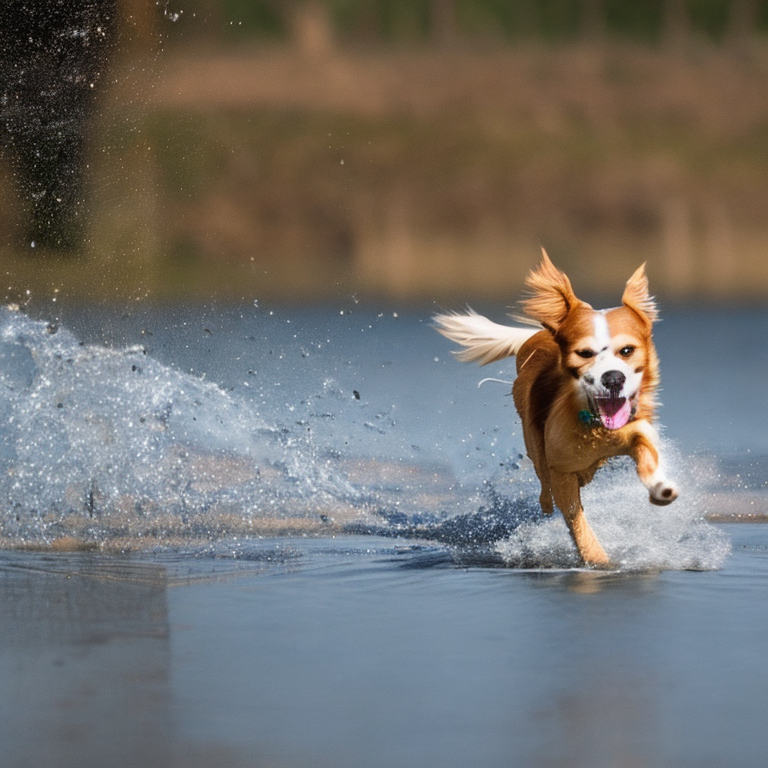

In [68]:
gen_sd_img(prompt='a dog running on water', seed =0)

## Prompting Stable Diffusion
In this section we will practice how to generate high quality, specific, and relevant images using Stable Diffusion prompting techniques.

You might be wondering why do we need to learn prompting?

Let's say we want to generate an image of  an eagle soaring majestically in the sky. A beginner might just write:

> 'A dog'

Let's use our custom function and generate an image using this prompt.

100%|██████████| 45/45 [00:07<00:00,  6.27it/s]


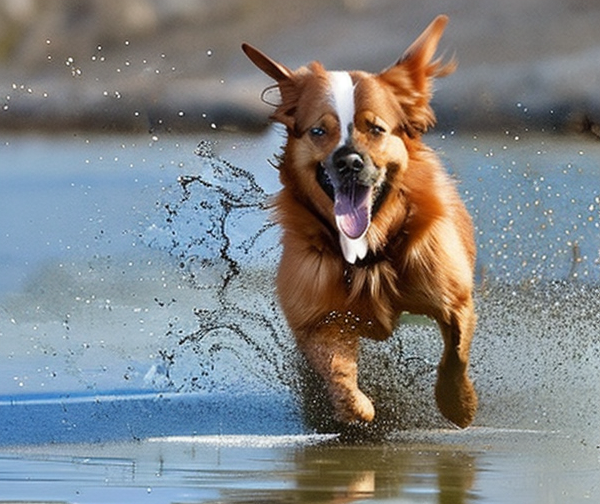

In [29]:
gen_sd_img(prompt="A dog running in the river", seed= 358870059)

# Let's improve our prompt and see if the result is better

100%|██████████| 45/45 [00:11<00:00,  4.05it/s]


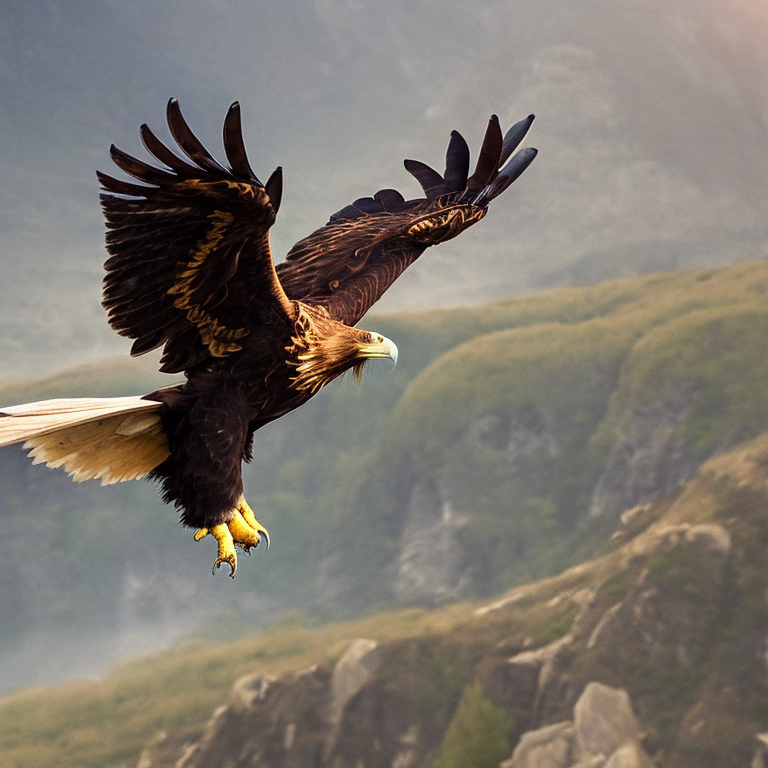

In [69]:
gen_sd_img(prompt="A majestic golden eagle soaring gracefully over a rugged terrain, with its wings widespread wide and sunlight gleaming off its feathers", seed= 358870059)

So, it is up to us to guide the model to generate an image we want. How do we do that? Well, there are some effective practices that we have to learn to create specific and precise prompts.
<br><br>

**How to create effective prompts?**
To craft an effective prompt, it's crucial to be detailed and specific. A good practice in prompting is to look for a list of keyword categories and select the ones that suits you needs.

Some categories:
* Subject
* Medium
* Style
* Artist
* Resolution
<br><br>

**Note:** You don't have to include all keywords from all categories.
<br><br>

The first category while writing a prompt is the ***subject***. Think of the subject as the heart of your image, what you truly want to see.

Let's say we want to generate an image of a cat sitting on a window sill.

100%|██████████| 45/45 [00:11<00:00,  3.91it/s]


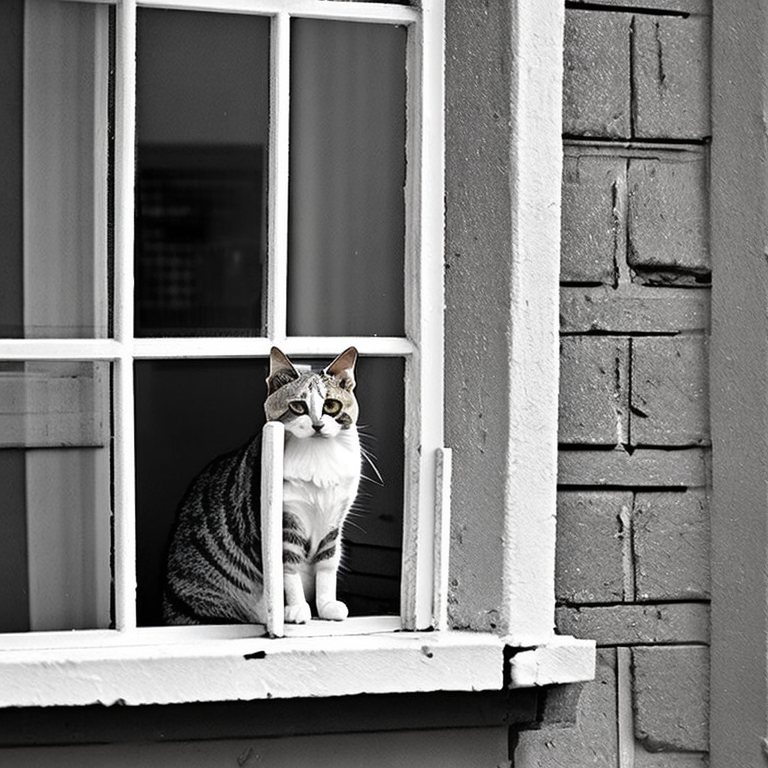

In [70]:
gen_sd_img(prompt="A cat sitting on a window sill",seed = 358870059)

Without specifying a ***medium***, the model is free to interpret the prompt using various artistic techniques. The result could be a digital painting, an oil portrait, a charcoal sketch, or any other medium depending on the model's training data and inherent creative choice
<br><br>

Next, let's add a keyword from the *medium* category.

100%|██████████| 45/45 [00:11<00:00,  3.97it/s]


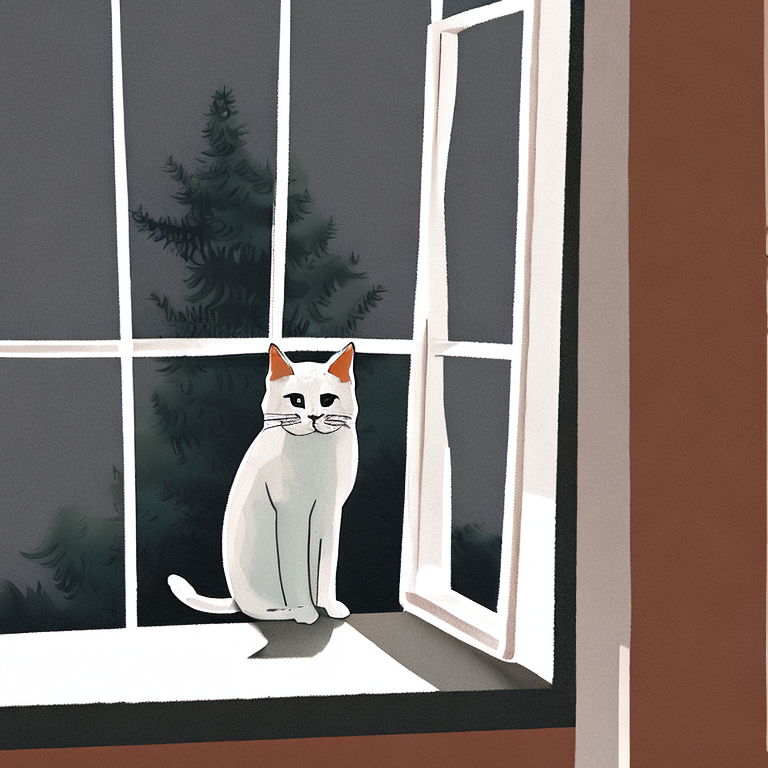

In [71]:
gen_sd_img(prompt = 'A digital illustration of a cat sitting on a window sill',
           seed = 358870059)

In this prompt, by mentioning *digital illustration* as the medium, the AI is directed to create the artwork using digital tools and techniques. The resulting image is likely to have clean lines, vibrant colors, and digital effects that are characteristic of digital illustrations.
<br><br>

Let's look at some more examples.

100%|██████████| 45/45 [00:11<00:00,  3.99it/s]


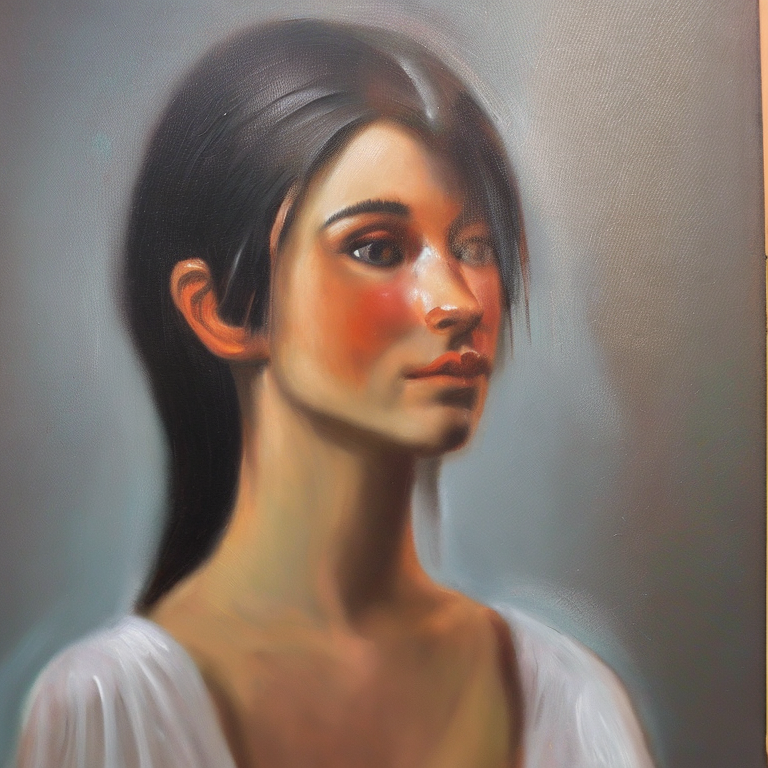

In [72]:
gen_sd_img(prompt = 'A woman, oil painting',
           seed = 358870059)

100%|██████████| 45/45 [00:11<00:00,  3.85it/s]


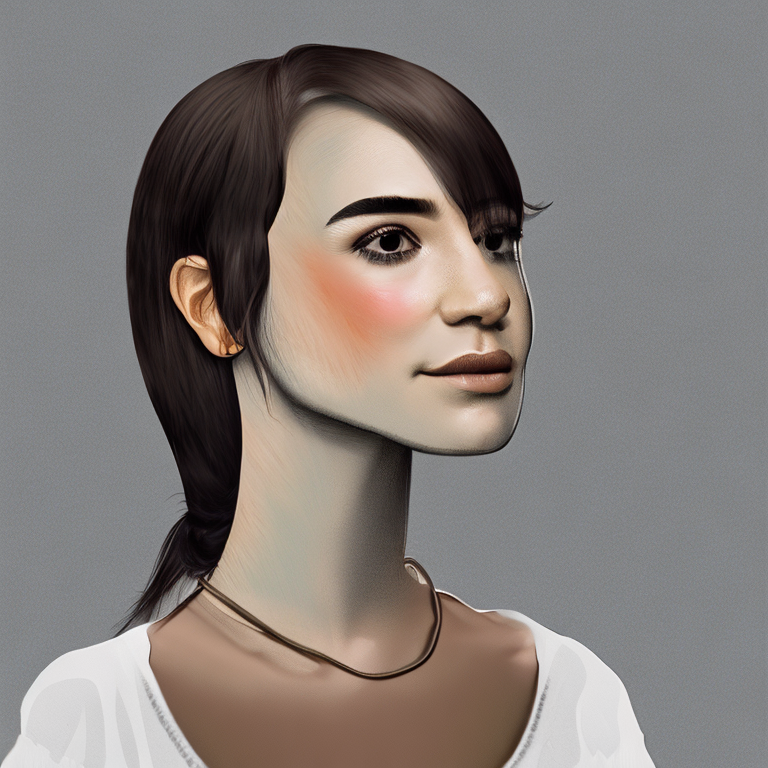

In [81]:
gen_sd_img(prompt = 'A digital illustration portrait of a woman',
           seed = 358870059)

By specifying the term *digital portrait*, the AI is guided to create the artwork digitally. The result is more likely to have the characteristics typical of digital artwork, such as sharp lines, precise detailing, and so on.

We can further improve our prompt  by adding a ***style*** to it. Style is the unique aesthetic and visual qualities of the generated images. It's like an artist's signature brushstroke or a photographer's distinctive framing. It gives the artwork its personality.
<br><br>

A style can be hyperrealistic, full body, fantasy, surrealist, and so on.

100%|██████████| 45/45 [00:11<00:00,  3.88it/s]


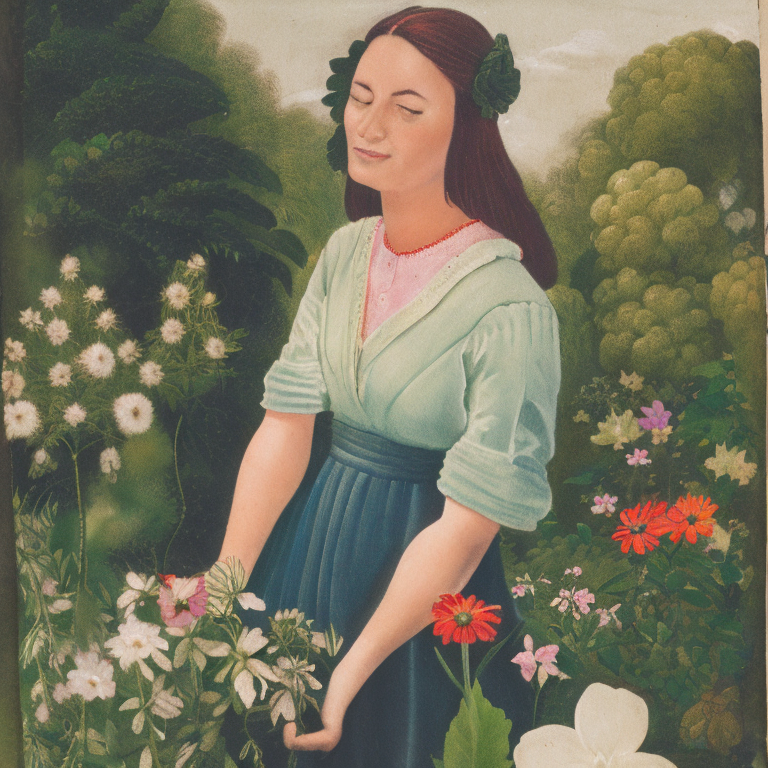

In [73]:
gen_sd_img(prompt = 'A woman in a garden holding a flower ',
           seed = 358870059)

100%|██████████| 45/45 [00:11<00:00,  3.95it/s]


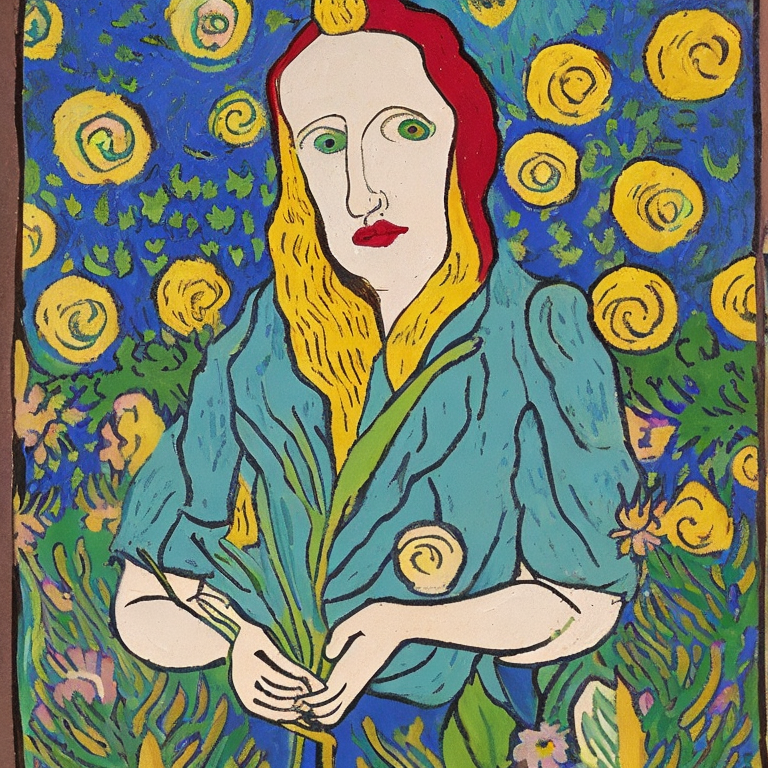

In [74]:
gen_sd_img(prompt = 'A woman with face standing in a garden holding a flower, in a van-gogh style',
           seed = 358870059)

Using artist names in our prompt is another technique that will help the model to generate the image based on something that is common rather than guessing what we need.

100%|██████████| 45/45 [00:11<00:00,  3.95it/s]


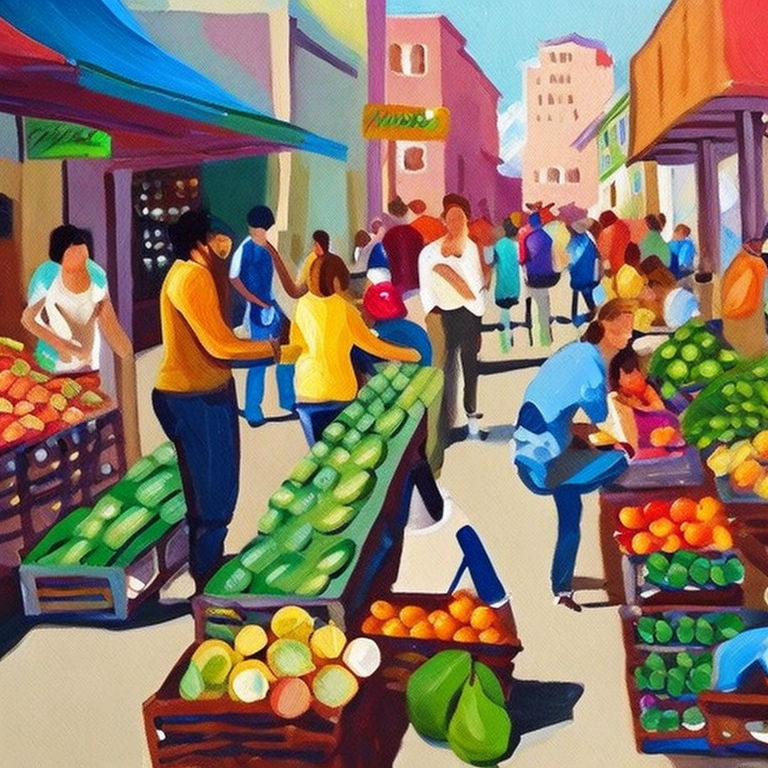

In [75]:
gen_sd_img(prompt = 'Paint a vibrant market scene with fruits, vegetables, and people',
           seed = 358870059)

In this prompt without specifying a particular artist, the AI is given general instructions to create a market scene with colorful elements. The result may vary widely and lack a specific artistic influence.

100%|██████████| 45/45 [00:11<00:00,  3.94it/s]


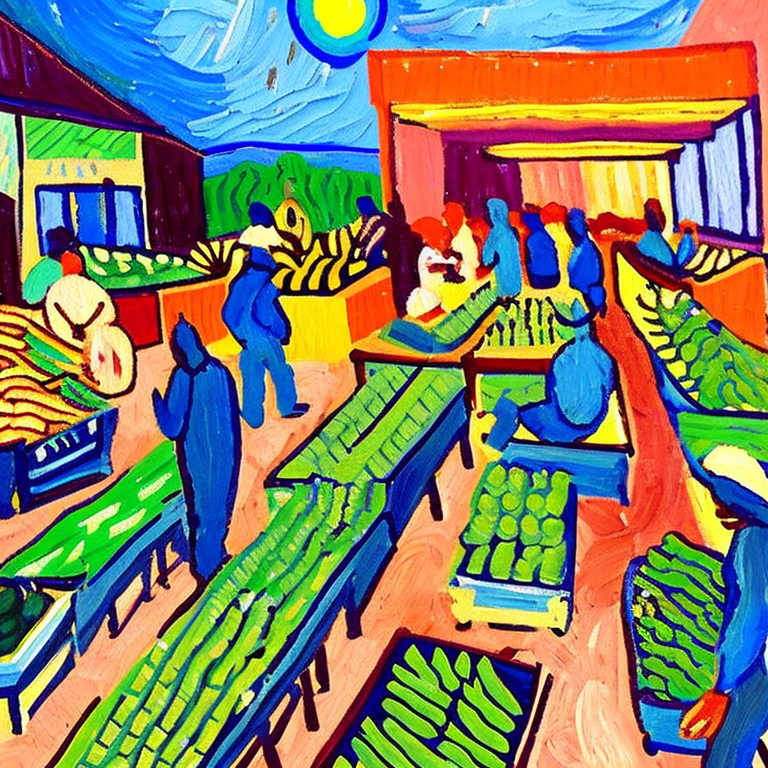

In [76]:
gen_sd_img(prompt = 'Paint a vibrant market scene with people buying fruits, vegetables in the style of Vincent van Gogh',
           seed = 358870059)

By referencing Van Gogh, the prompt guides the AI to emulate the unique style of the renowned artist. This could result in bold, expressive brushstrokes, vibrant colors, and dynamic compositions characteristic of Van Gogh's work.

100%|██████████| 45/45 [00:11<00:00,  3.93it/s]


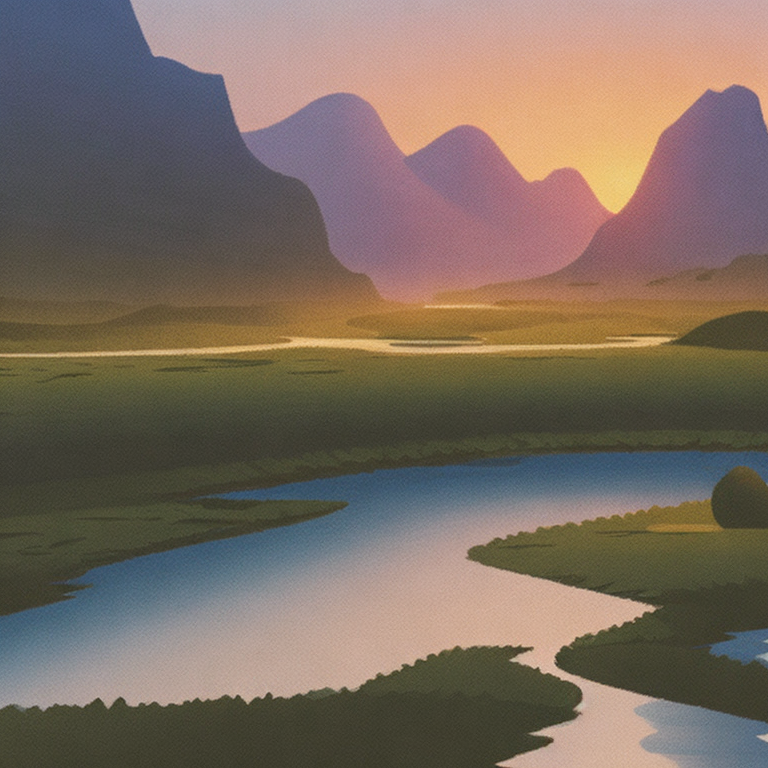

In [77]:
gen_sd_img(prompt = 'A serene landscape with mountains, a river, and a sunset',
           seed = 358870059)

The above result could be influenced by various landscape artists, leading to a more generalized representation. Now, we add the artist name.

100%|██████████| 45/45 [00:11<00:00,  3.92it/s]


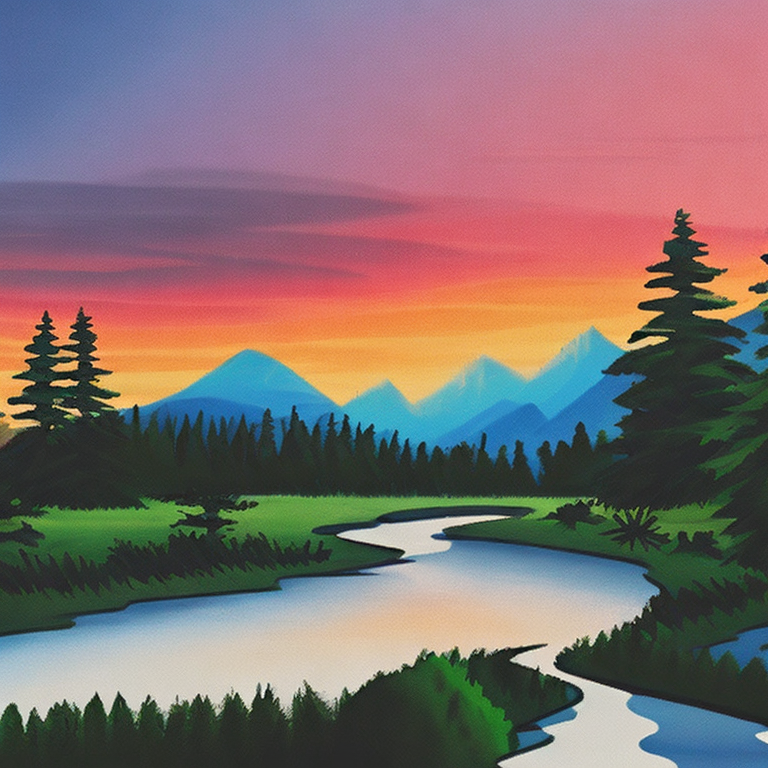

In [78]:
gen_sd_img(prompt = 'A serene landscape reminiscent of a Bob Ross painting, featuring mountains, a river, and a sunset',
           seed = 358870059)

100%|██████████| 45/45 [00:11<00:00,  3.93it/s]


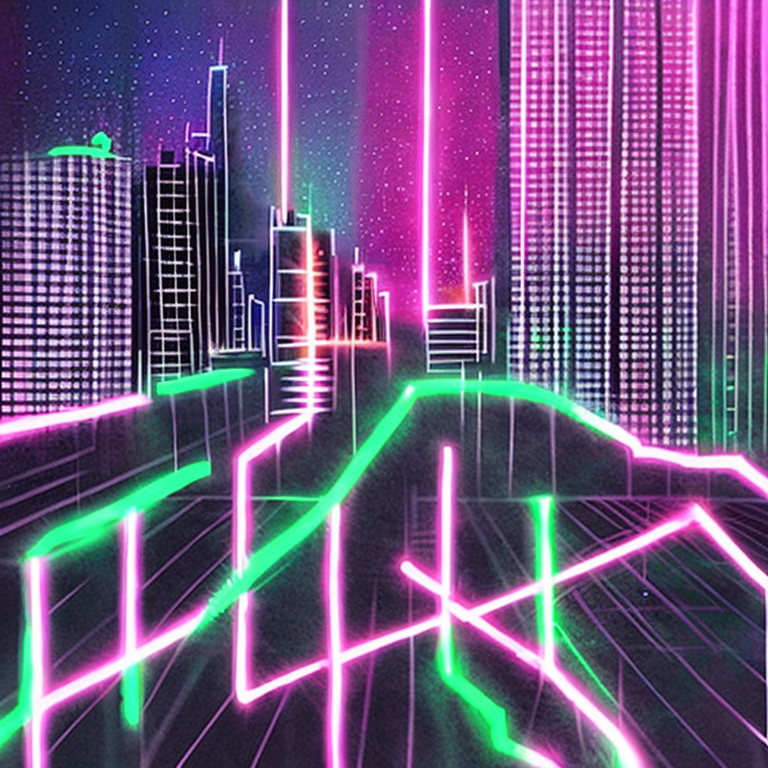

In [79]:
gen_sd_img(prompt = 'Create a digital artwork of a city skyline at night with neon lights',
           seed = 358870059)

In this prompt, without specifying the resolution, the AI will generate the image at a default resolution, which might vary depending on the platform or settings. The output could be of standard quality and size, suitable for general viewing but not necessarily optimized for specific uses like printing or high-quality digital displays.

100%|██████████| 45/45 [00:11<00:00,  3.89it/s]


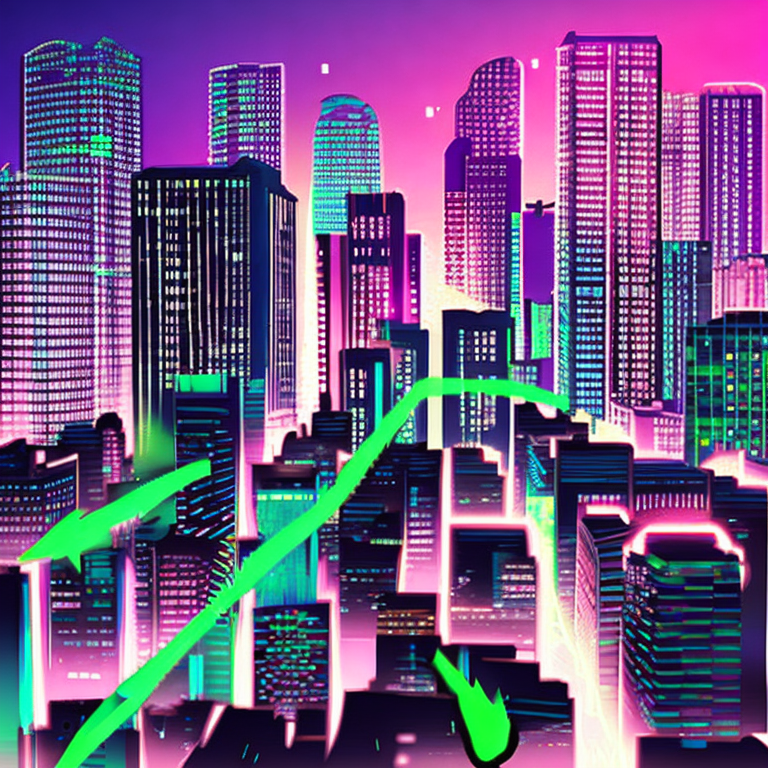

In [80]:
gen_sd_img(prompt = 'Create a high-resolution digital artwork (at least 6000x4000 pixels) of a city skyline at night with neon lights',
           seed = 358870059)

In this prompt, by specifying the resolution (6000x4000 pixels), the AI is guided to generate a high-quality, detailed image suitable for printing or large digital displays. The output will have a higher pixel density, ensuring sharpness and clarity even in larger formats.

Finally, let's add some additional details to modify the output images further.

100%|██████████| 45/45 [00:11<00:00,  3.95it/s]


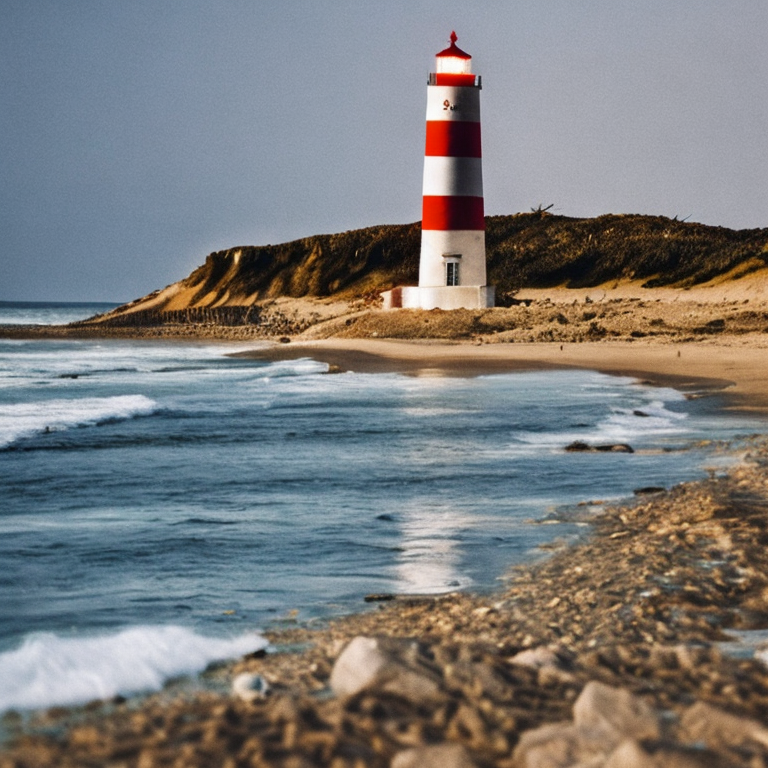

In [66]:
gen_sd_img(prompt = 'A beach with a lighthouse',
           seed = 358870059)

In this prompt, the AI has minimal information to work with. It may generate a basic beach scene with a lighthouse, but the lack of specific details leaves room for creative interpretation. The resulting image could vary widely in terms of style, mood, and level of detail.

100%|██████████| 45/45 [00:11<00:00,  4.01it/s]


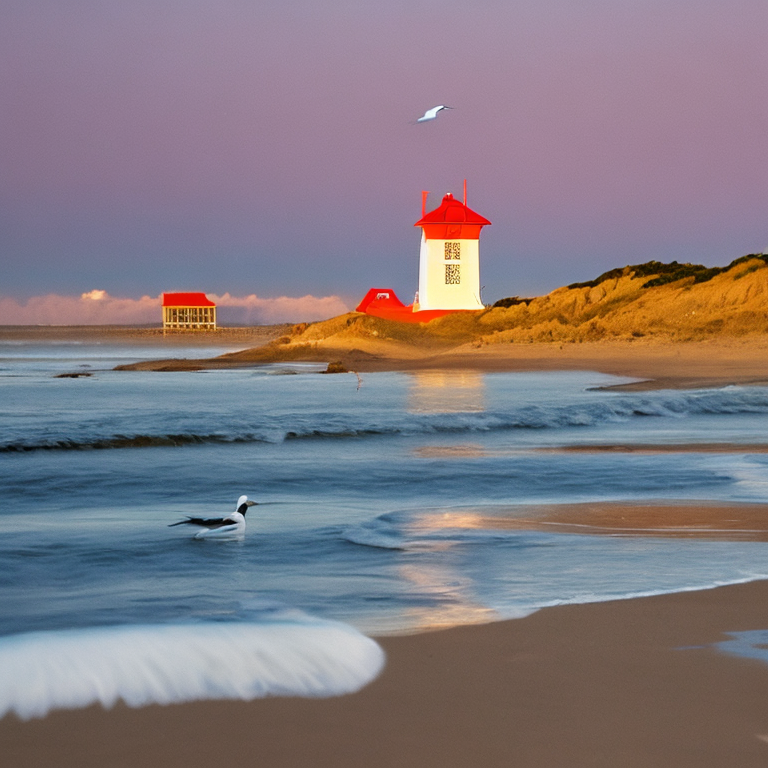

In [65]:
gen_sd_img(prompt = 'A serene beach at sunrise with a weathered, red-and-white striped lighthouse, golden morning light, seagulls gracefully circling above the calm, azure waters',
           seed = 358870059)

100%|██████████| 45/45 [00:11<00:00,  3.99it/s]


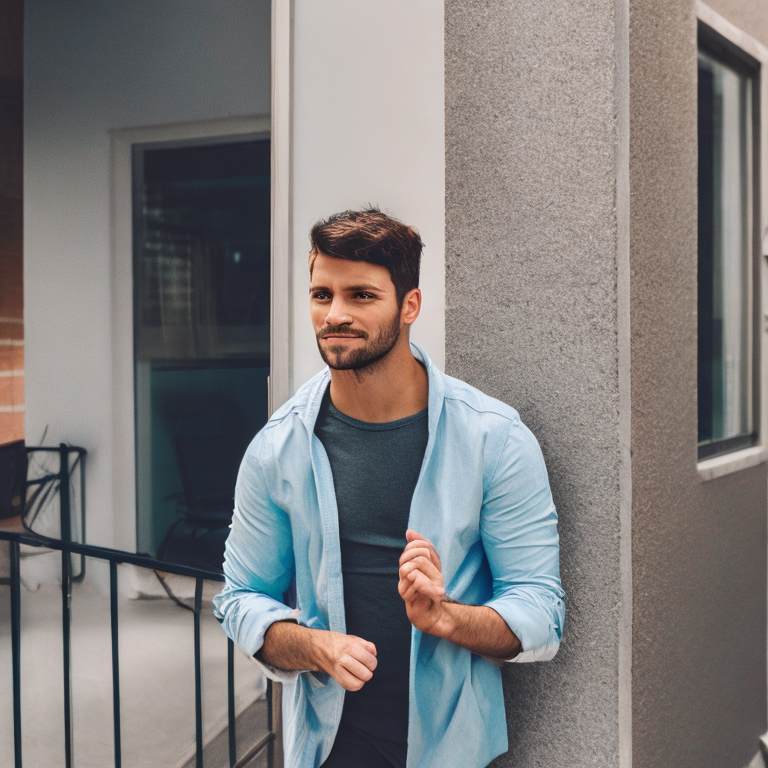

In [64]:
gen_sd_img(prompt = 'A man waking in neighbourhood, with good outfit, perfect face',
           seed = 358870059)

If you notice in the above image generated, We can see that there are irregular looking features of the subject such as the hands. Hence, we can add a negative prompt to fix the image and get the desired output.

100%|██████████| 45/45 [00:11<00:00,  4.08it/s]


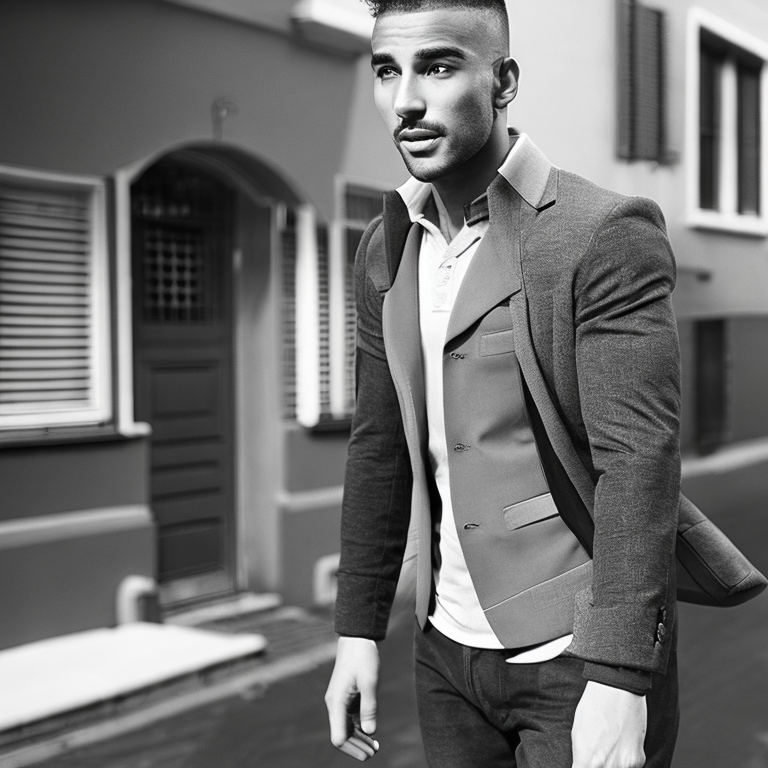

In [82]:
gen_sd_img(prompt='A man waking in neighbourhood, with good outfit, perfect face, detailed facial features',
          negative_prompt='ugly, poorly drawn hands, poorly drawn face',
           seed = 358870059 )

You can see that this time, the model has produced a much better and more relevant image. This is the importance of negative prompting in Stable Diffusion.

100%|██████████| 45/45 [00:11<00:00,  4.06it/s]


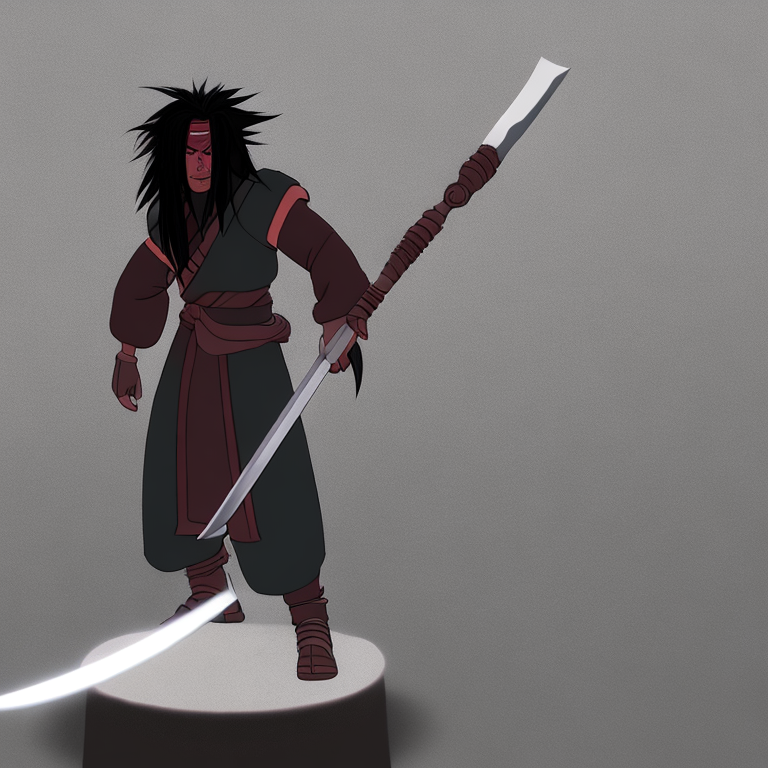

In [83]:
gen_sd_img(prompt = 'Madara in battleground, holding a sword, detailed face, cinematic',
           seed = 358870059)

100%|██████████| 45/45 [00:11<00:00,  4.05it/s]


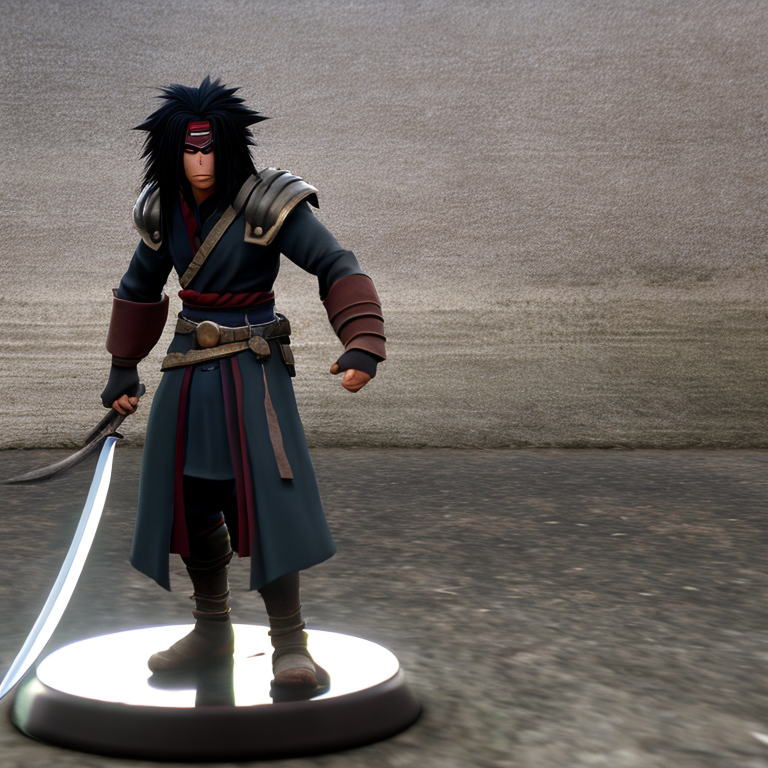

In [84]:
gen_sd_img(prompt = 'Madara in battleground, holding a sword, detailed face, cinematic',
           negative_prompt = 'ugly, weird faces, poorly drawn hands, poorly drawn legs, offset in frame',
           seed = 358870059)

Again the model has perfected the issues that occured in the initial generation of the image without a negative prompt. Therefore, it is crucial to provide a negative prompt in order to generate images and fine-tune them into our desired output.
<br><br>

The following is a decent boilerplate negative prompt without affecting styles

> ***ugly, tiling, poorly drawn hands, poorly drawn feet, poorly drawn face, out of frame, extra limbs, disfigured, deformed, body out of frame, bad anatomy, watermark, signature, cut off, low contrast, underexposed, overexposed, bad art, beginner, amateur, distorted face***
<br><br>

Let us utilize the above negative prompt in one of the above generated images.

100%|██████████| 45/45 [00:11<00:00,  4.05it/s]


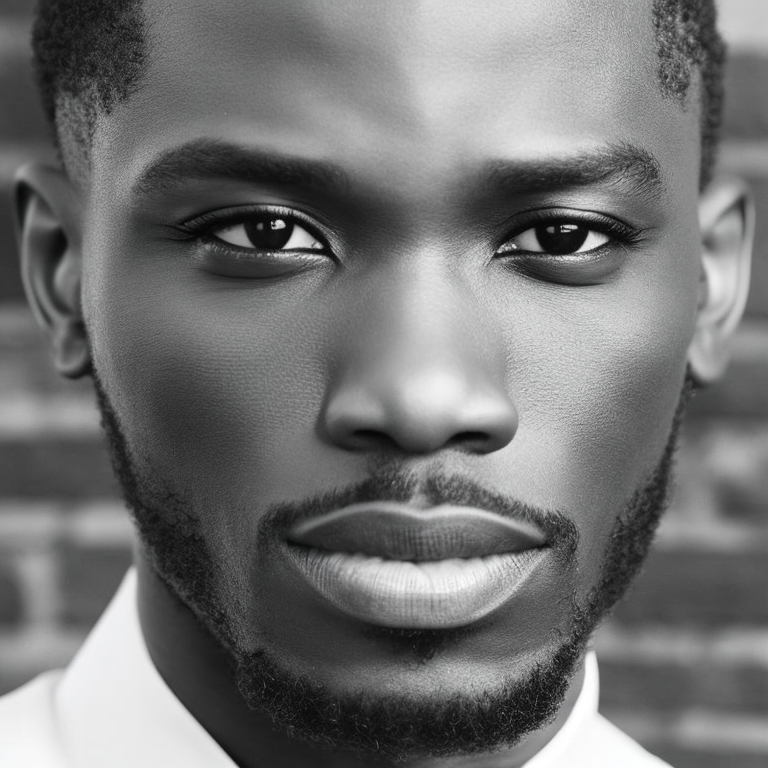

In [86]:
gen_sd_img(prompt = 'A man, perfect face with good outfit, detailed facial features',
           negative_prompt = 'ugly, tiling, poorly drawn hands, poorly drawn feet, poorly drawn face, out of frame, extra limbs, disfigured, deformed, body out of frame, bad anatomy, watermark, signature, low contrast, underexposed, overexposed, bad art, beginner, amateur, closed eyes, distorted face',
           seed = 358870059)

100%|██████████| 45/45 [00:11<00:00,  4.00it/s]


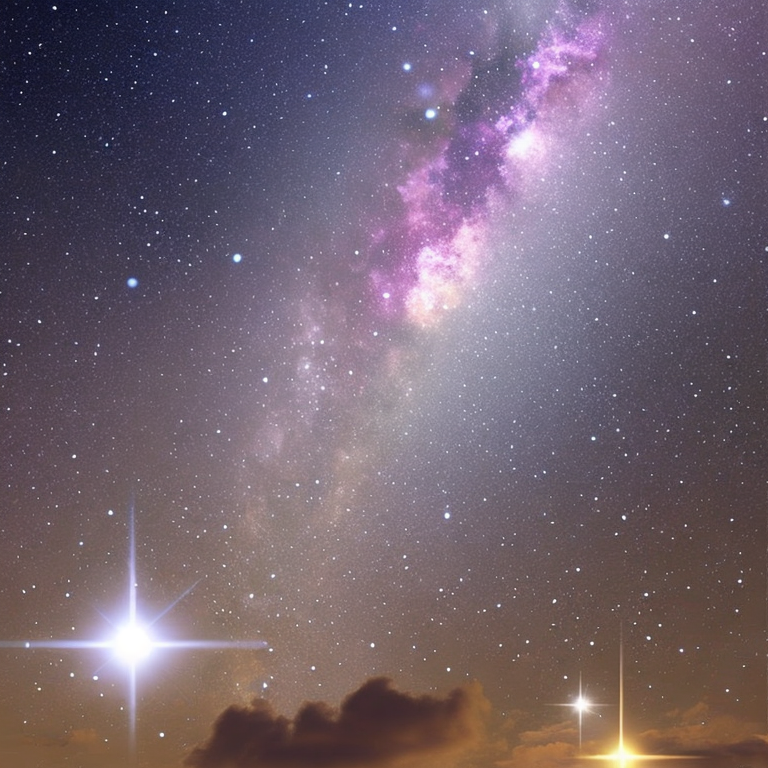

In [102]:
gen_sd_img(prompt = 'realistic high detailed photo of night sky with (clouds:0.5 and stars:10 )',
           negative_prompt = 'aircraft, tree branches',
           seed = 358870059)

In summary, negative prompts and keyword weight provide essential tools for guiding diffusion models, enabling users to establish boundaries, enforce ethical guidelines, and fine-tune output to meet specific requirements while ensuring responsible use.